## Libraries and Modules

In [ ]:
import glob
from tensorflow.keras.preprocessing import image
import numpy as np
import pandas as pd
import cv2
from tqdm.auto import tqdm
import os
from matplotlib import pyplot as plt
from tensorflow.keras.preprocessing import image
from keras.models import Model
from tensorflow.keras.utils import load_img
from tensorflow.keras.preprocessing.image import smart_resize
import pandas as pd
import numpy as np
from sklearn.decomposition import PCA
from sklearn.cluster import DBSCAN
from sklearn.cluster import OPTICS
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from IPython.display import Image, display
from tensorflow import keras
!pip install scipy
import scipy
import pylab as pl
from PIL import Image
import json
import seaborn as sns
%matplotlib inline

from google.colab import drive
drive.mount('/content/drive')

images_path = "/content/drive/MyDrive/Image-Clustering-v3/Screenshots/"
img_names = list(glob.glob("/content/drive/MyDrive/Image-Clustering-v3/Screenshots/"+'*.jpg'))

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Functions

### Get Embeddings

In [ ]:
def z_norm(df,epsilon=10e-10):
    return (df-df.mean())/(df.std()+epsilon)

def min_max_norm(df,epsilon=10e-10):
    return (df-df.min())/(df.max()-df.min()+epsilon)

def exp_norm(df,epsilon=10e-10):
    em = df.to_numpy()
    mean = np.mean(em,axis=0)
    lam = 1/(mean+epsilon)
    exfit = lam*np.exp(-lam*em)
    exfit = (exfit - np.min(exfit,axis=0)) / (np.max(exfit,axis=0)-np.min(exfit,axis=0)+epsilon)
    return pd.DataFrame(exfit,index=df.index)

In [ ]:
def extract_features(file, model,input_shape):
    img = image.load_img(file)
    img = image.img_to_array(img)
    img = smart_resize(img, (input_shape,input_shape), interpolation='bilinear')
    img = np.expand_dims(img, axis=0)
    features = model.predict(img, use_multiprocessing=True)
    return features.ravel()

def frame_embeddings(data,normalize=None):
    embedding_df = pd.DataFrame.from_dict(data)
    embedding_df = embedding_df.T
    print(embedding_df.shape)
    if normalize is not None : embedding_df = normalize(embedding_df)
    embedding_df['image'] = embedding_df.index
    embedding_df = embedding_df.reset_index()
    embedding_df = embedding_df.drop(['index'], axis=1)
    return embedding_df

def get_embeddings(model,input_shape,normalize=None):
    data = {}
    for img in img_names:
      feat = extract_features(img,model,input_shape)
      data[img] = feat
    embedding_df = frame_embeddings(data,normalize)
    return embedding_df

### Dimensionality Reduction

In [ ]:
def dimension_reduction(embedding_df,components):
  pca = PCA(n_components=components)
  pca.fit(embedding_df.drop(columns='image'))
  p = pca.transform(embedding_df.drop(columns='image'))
  print('###############################################')
  print('number of pca components',len(pca.components_))
  print('###############################################')
  
  return p

### Clustering

In [ ]:
def image_clustering(embedding_df,principal_cp,algorithm,return_stats=False):
    cluster       = algorithm.fit(principal_cp)
    labels        = cluster.labels_
    classified    = len([x for x in labels if x>=0])
    num_cls       = len(np.unique(labels))
    unique_counts = np.unique(labels, return_counts=True)
    avg_cls       = np.mean(np.where(unique_counts[0] > -1,unique_counts[1],0))
    std_cls       = np.std( unique_counts[1] )
    print('___________________________________________________________________')
    print('number of clusters    : ',num_cls)
    print('classified points     : ',classified)
    print('average cluster pop   : ',avg_cls)
    print('standard deviation    : ',std_cls)
    curr_df = pd.DataFrame()
    curr_df['cluster'] = labels
    df = pd.concat([embedding_df["image"],curr_df["cluster"]], axis=1)
    if return_stats==True:
      dic = {}
      dic['clusters'] = num_cls
      dic['coverage'] = classified
      dic['avg']      = avg_cls
      dic['std']      = std_cls
      return df,dic

    return df,classified, avg_cls

### Experiment

In [ ]:
def experiment(model,input_shape,normalize,components,algorithm):
  embedding_df = get_embeddings(model,input_shape,normalize)
  principal_cp = dimension_reduction(embedding_df,components)
  df,classes,avg_pop = image_clustering(embedding_df,principal_cp,algorithm)
  return df,classes,avg_pop

def experiment_loop(model,input_shape,normalize,components,min_samples,xi):
  embedding_df = get_embeddings(model,input_shape,normalize)
  class_grid = []
  avpop_grid = []
  for i in range(components[0],components[1],components[2]):
    crow = []
    prow = []
    principal_cp = dimension_reduction(embedding_df,i)
    for j in range(min_samples[0],min_samples[1],min_samples[2]):
      ccol = []
      pcol = []
      for k in np.arange(xi[0],xi[1],xi[2]):
        algorithm   = OPTICS(min_samples=j, xi=k)
        df,classes,avg_pop = image_clustering(embedding_df,principal_cp,algorithm)
        print(i,j,k)
        ccol.append(classes)
        pcol.append(avg_pop)
      crow.append(ccol)
      prow.append(pcol)
    class_grid.append(crow)
    avpop_grid.append(prow)
  return class_grid, avpop_grid


def stats_experiment_loop(model,input_shape,normalize,components,min_samples,xi):
  embedding_df = get_embeddings(model,input_shape,normalize)
  grid = []
  for i in range(components[0],components[1],components[2]):
    row = []
    principal_cp = dimension_reduction(embedding_df,i)
    for j in range(min_samples[0],min_samples[1],min_samples[2]):
      col = []
      for k in np.arange(xi[0],xi[1],xi[2]):
        algorithm   = OPTICS(min_samples=j, xi=k)
        df,stats = image_clustering(embedding_df,principal_cp,algorithm,return_stats=True)
        print(i,j,k)
        stats['stats']=str(i)+'_'+str(j)+'_'+str(k)
        col.append(stats)
      row.append(col)
    grid.append(row)
  return grid

### Utilities

In [ ]:
def save_grid(mat,name):
  with open(name, "w") as fp:
    json.dump(mat, fp)
  return

def read_grid(name):
  with open(name, "r") as fp:
    grid = json.load(fp)
  return grid
  
def show_contour(grid,dim1,dim2):
  if dim1+dim2   == 1: grid = np.mean(grid,axis=2)
  elif dim1+dim2 == 2: grid = np.mean(grid,axis=1)
  elif dim1+dim2 == 3: grid = np.mean(grid,axis=0)

  print(grid.shape)

  X, Y = np.meshgrid(np.linspace(0,1,grid.shape[1]), np.linspace(0,1,grid.shape[0]))
  plt.contourf(X,Y,grid,cmap='gist_rainbow_r')
  plt.show()
  return

def open_image(image):
  image = Image.open(image)
  plt.imshow(image)
  plt.show()
  return

def clust_in_df(df,clust_id):
  return df.loc[df['cluster'] == clust_id]["image"]


def search_stat_grid(grid,ncls,cov,avg,std,return_list=False):
  lis = []
  counter = 1
  for i in range(len(grid)):
    for j in range(len(grid[i])):
      for k in range(len(grid[i][j])):
        #print(grid[i][j][k])
        if ncls[0] > grid[i][j][k]['clusters'] or grid[i][j][k]['clusters'] > ncls[1]:
          continue
        if cov[0] > grid[i][j][k]['coverage'] or grid[i][j][k]['coverage'] > cov[1]:
          continue
        if avg[0] > grid[i][j][k]['avg'] or grid[i][j][k]['avg'] > avg[1]:
          continue
        if std[0] > grid[i][j][k]['std'] or grid[i][j][k]['std'] > std[1]:
          continue
        if return_list == True:
          lis.append(grid[i][j][k])
          continue
        print(counter,grid[i][j][k])
        counter += 1
  if return_list == True: return lis
  return


##Run

In [ ]:
#                                                                           Parameters
input_shape = 224
model       = keras.applications.ResNet50V2(include_top=False,weights='imagenet',input_shape=(input_shape,input_shape,3),pooling='avg')
algorithm   = OPTICS(min_samples=3, xi=0.05)
components  = 15
epsilon     = 10e-10
norm_func   = z_norm

94668760/94668760 [==============================] - 1s 0us/step


### Grid Search

In [ ]:
class_grid, avpop_grid = experiment_loop(model,input_shape,None,[5,25,5],[2,7,1],[0.05,0.1,0.01])

In [ ]:
print(np.array(class_grid).shape)
print('xi independent')
show_contour(avpop_grid,0,1)
print('pca independent')
show_contour(avpop_grid,1,2)
print('min independent')
show_contour(avpop_grid,2,0)

print('xi independent')
show_contour(class_grid,0,1)
print('pca independent')
show_contour(class_grid,1,2)
print('min independent')
show_contour(class_grid,2,0)

In [ ]:
'''
save_grid(class_grid,'class_grid')
save_grid(avpop_grid,'avpop_grid')

class_grid = read_grid('class_grid')
avpop_grid = read_grid('avpop_grid')
'''

In [ ]:
cl = np.array(class_grid).reshape(1,-1).ravel().tolist()
cl.sort(reverse=True)
for each in cl:
  print()
  print(each,'->',np.where(np.array(class_grid)==each))

### Single Experiment

In [ ]:
df = experiment(model,input_shape,z_norm,components,algorithm)

1/1 [==============================] - 0s 18ms/step
(838, 512)
###############################################
number of pca components 20
###############################################
___________________________________________________________________
number of clusters    :  18
classified points     :  64
average cluster pop   :  46.55555555555556
standard deviation    :  176.43482341527775


In [ ]:
for clust_no in range(0,10):
  print("##################",clust_no,"##################")
  clust_list = list(clust_in_df(df[0],clust_no))
  for im in clust_list: open_image(im)

##Correction Experiment

### Multi Model Correction

In [ ]:
#                                                                           Parameters
input_shape = 224
model       = keras.applications.ResNet50(include_top=False,weights='imagenet',input_shape=(input_shape,input_shape,3),pooling='avg')
algorithm   = OPTICS(min_samples=3, xi=0.03)
components  = 20
epsilon     = 10e-10

In [ ]:
def rem_image_col(lis):
  return [ x.drop(columns='image') for x in lis ]
mod1  = keras.applications.VGG16(include_top=False,weights='imagenet',input_shape=(input_shape,input_shape,3),pooling='avg')
mod2  = keras.applications.VGG19(include_top=False,weights='imagenet',input_shape=(input_shape,input_shape,3),pooling='avg')
mod7  = keras.applications.MobileNet(include_top=False,weights='imagenet',input_shape=(input_shape,input_shape,3),pooling='avg')
mod8  = keras.applications.MobileNetV2(include_top=False,weights='imagenet',input_shape=(input_shape,input_shape,3),pooling='avg')
mod9  = keras.applications.NASNetMobile(include_top=False,weights='imagenet',input_shape=(input_shape,input_shape,3),pooling='avg')


edf0           = get_embeddings(model,input_shape,None).reset_index()
model_list     = [mod1,mod2,mod7,mod8,mod9]
embedding_list = [get_embeddings(m,input_shape,None).reset_index().drop(columns='image') for m in model_list]
embedding_list.append(edf0)

Streaming output truncated to the last 5000 lines.
1/1 [==============================] - 0s 35ms/step
(838, 1280)
1/1 [==============================] - 0s 34ms/step
(838, 1408)
1/1 [==============================] - 0s 34ms/step
(838, 1536)
1/1 [==============================] - 0s 58ms/step
(838, 1280)
1/1 [==============================] - 0s 41ms/step
(838, 1280)
1/1 [==============================] - 0s 32ms/step
(838, 1280)


In [ ]:
embedding_df = pd.concat(embedding_list, axis=1)
embedding_df = embedding_df.drop(columns='index')
embedding_df

,0,1,2,3,4,5,6,7,8,9,...,2039,2040,2041,2042,2043,2044,2045,2046,2047,image
0,0.502005,8.077882,5.296745,6.659776,1.361851,0.192825,5.450482,0.628101,0.005162,2.719360,...,0.150426,1.346896,1.175361,1.500780,0.200091,0.125594,0.000000,0.000000,0.843120,/content/drive/MyDrive/Image-Clustering-v3/Scr...
1,0.085936,3.867893,1.739090,1.297629,1.724607,0.565149,0.000000,4.943489,0.000000,4.162345,...,0.001119,0.000000,0.108383,1.462529,0.248344,0.271671,0.537344,0.616010,1.938071,/content/drive/MyDrive/Image-Clustering-v3/Scr...
2,0.049696,0.112166,1.568918,0.000000,0.008140,0.410622,0.000000,2.855428,0.369852,1.167774,...,0.006759,0.181568,0.188595,0.548085,0.002676,0.292956,0.378580,0.060291,1.172027,/content/drive/MyDrive/Image-Clustering-v3/Scr...
3,0.359758,1.352652,0.840787,0.244337,0.000000,0.000000,0.114583,1.040070,0.821625,0.297613,...,0.010786,0.232837,0.125857,0.896172,0.093840,0.038677,0.035951,0.000000,0.732419,/content/drive/MyDrive/Image-Clustering-v3/Scr...
4,0.000000,0.406834,0.467324,0.000000,0.263387,0.000000,2.248111,1.536185,1.547099,0.612426,...,0.361499,1.224625,2.846365,0.818755,0.016208,0.000000,0.530213,0.242255,0.283294,/content/drive/MyDrive/Image-Clustering-v3/Scr...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
833,0.298648,0.000000,0.000000,0.117031,1.427592,0.690456,3.980458,0.000000,0.000000,0.000000,...,0.040089,0.039485,0.000000,0.259255,0.019420,0.001551,0.016852,0.083377,0.028854,/content/drive/MyDrive/Image-Clustering-v3/Scr...
834,0.000000,0.000000,0.000000,0.000000,3.310964,0.000000,0.109776,0.000000,0.000000,1.394674,...,0.063673,0.294961,0.001883,0.120551,0.023087,0.023317,0.000000,0.121188,0.000000,/content/drive/MyDrive/Image-Clustering-v3/Scr...
835,2.585273,2.509174,1.282900,1.587114,0.489977,0.000000,0.648160,2.940530,0.018479,1.950742,...,0.090464,0.837161,0.462004,0.931071,0.128729,0.000000,0.458398,0.586393,0.233626,/content/drive/MyDrive/Image-Clustering-v3/Scr...
836,2.928822,5.138607,6.991542,4.518559,0.000000,0.164427,0.434509,1.126652,8.774543,0.265191,...,0.379123,0.967207,1.780271,0.045524,0.000000,0.066375,0.251267,0.007832,0.256501,/content/drive/MyDrive/Image-Clustering-v3/Scr...


In [ ]:
em = embedding_df
em = em.drop(columns='image')
em = em.to_numpy()
mean = np.sum(em,axis=0)/em.shape[0]
lam  = 1/(mean+epsilon)
exfit = lam*np.exp(-lam*em)
exfit = (exfit - np.min(exfit,axis=0)) / (np.max(exfit,axis=0)-np.min(exfit,axis=0)+epsilon)

<ipython-input-73-00573c881354>:6: RuntimeWarning: overflow encountered in exp
  exfit = lam*np.exp(-lam*em)
<ipython-input-73-00573c881354>:6: RuntimeWarning: overflow encountered in multiply
  exfit = lam*np.exp(-lam*em)
<ipython-input-73-00573c881354>:7: RuntimeWarning: invalid value encountered in subtract
  exfit = (exfit - np.min(exfit,axis=0)) / (np.max(exfit,axis=0)-np.min(exfit,axis=0)+epsilon)
<ipython-input-73-00573c881354>:7: RuntimeWarning: invalid value encountered in true_divide
  exfit = (exfit - np.min(exfit,axis=0)) / (np.max(exfit,axis=0)-np.min(exfit,axis=0)+epsilon)


In [ ]:
ex = pd.DataFrame(exfit)
ex['image'] = embedding_df['image']
principal_cp = dimension_reduction(embedding_df,components)
df,classes,avg_pop = image_clustering(embedding_df,principal_cp,algorithm)

###############################################
number of pca components 20
###############################################
___________________________________________________________________
number of clusters    :  51
classified points     :  212
average cluster pop   :  16.431372549019606
standard deviation    :  86.22070514763449


################## 0 ##################


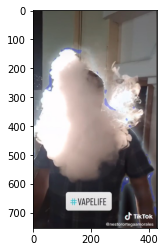

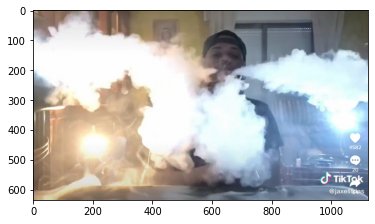

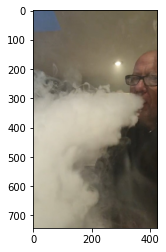

################## 1 ##################


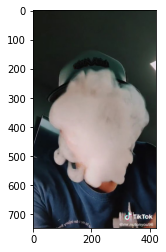

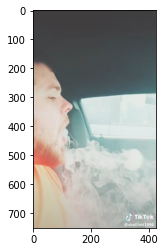

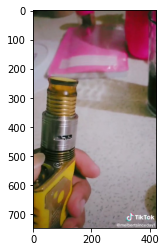

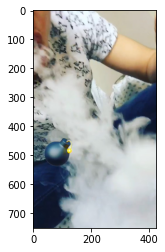

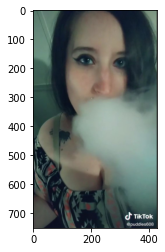

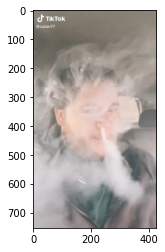

################## 2 ##################


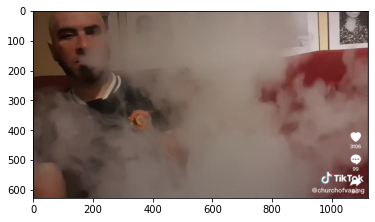

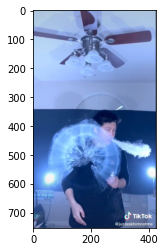

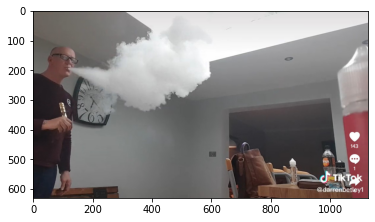

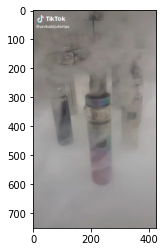

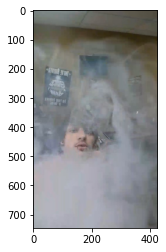

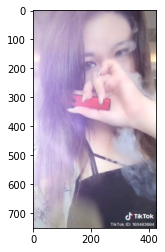

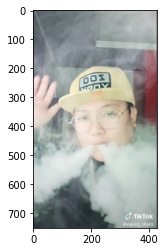

################## 3 ##################


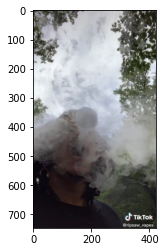

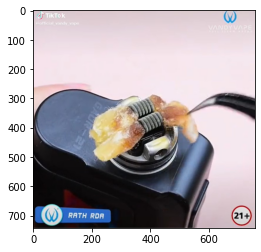

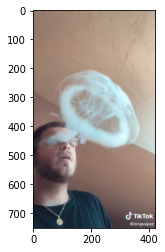

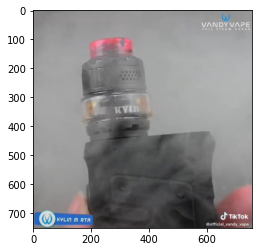

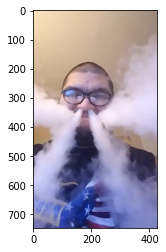

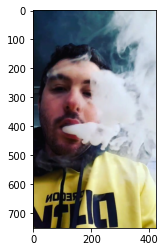

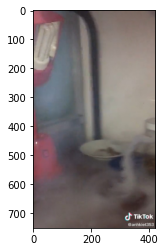

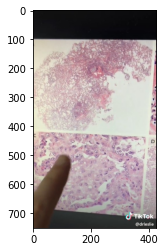

################## 4 ##################


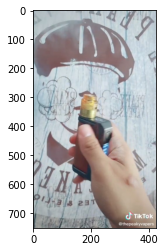

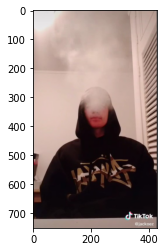

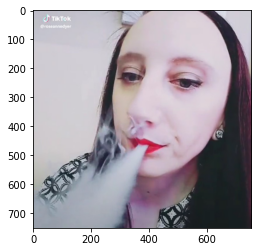

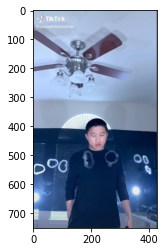

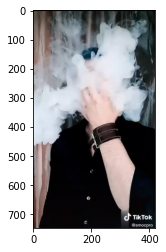

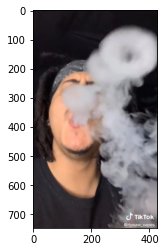

################## 5 ##################


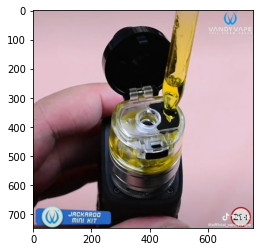

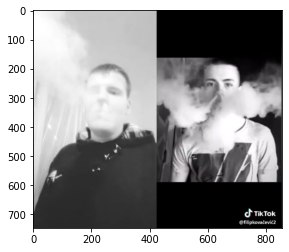

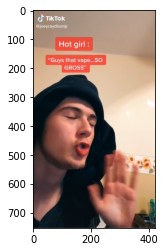

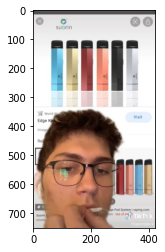

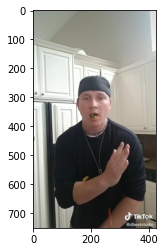

################## 6 ##################


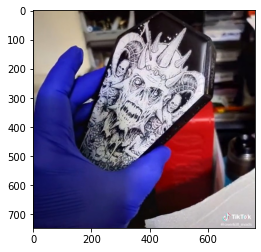

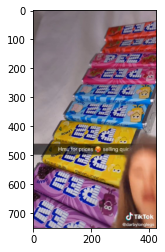

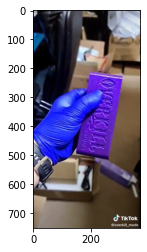

################## 7 ##################


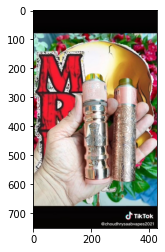

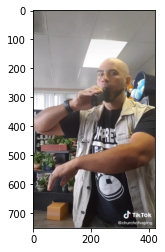

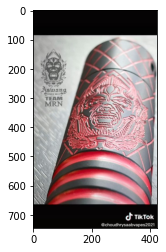

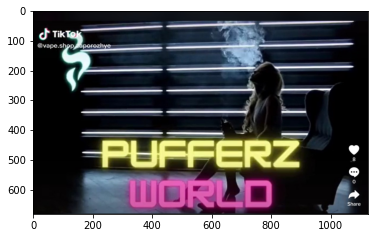

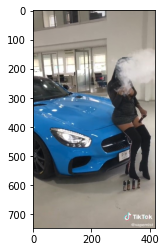

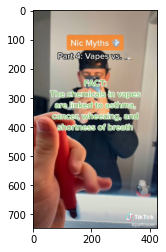

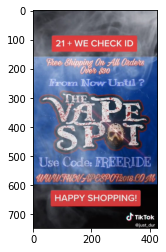

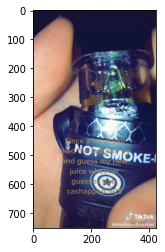

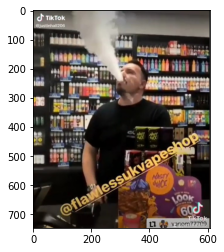

################## 8 ##################


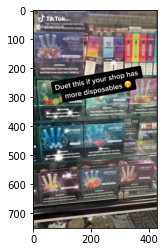

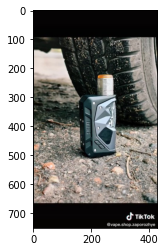

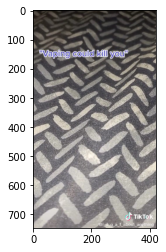

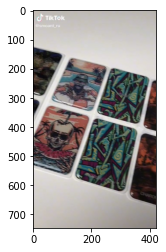

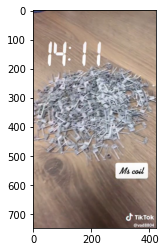

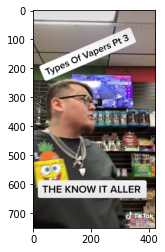

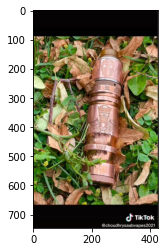

################## 9 ##################


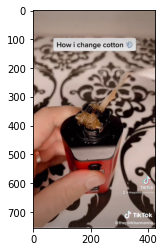

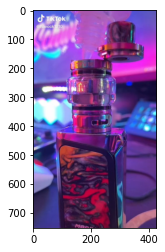

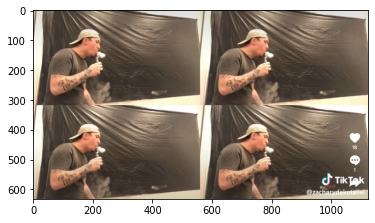

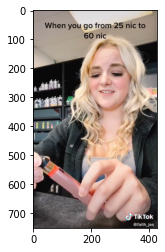

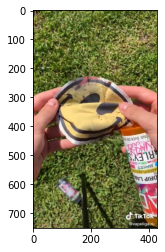

################## 10 ##################


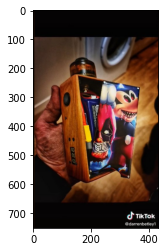

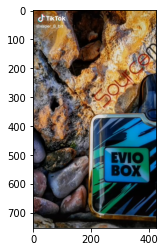

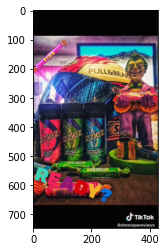

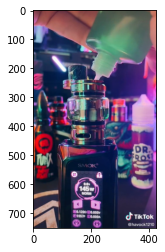

################## 11 ##################


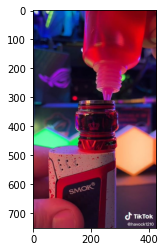

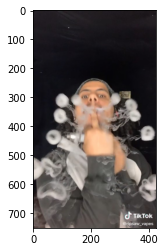

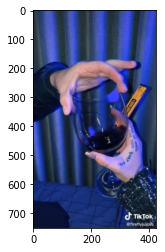

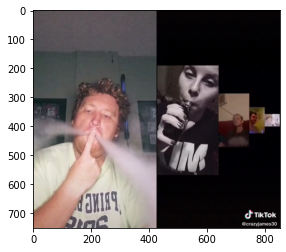

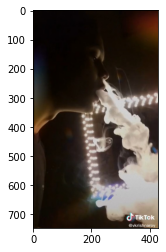

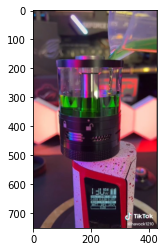

################## 12 ##################


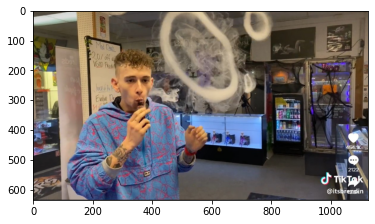

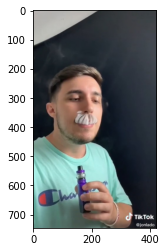

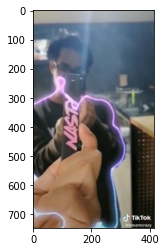

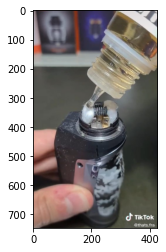

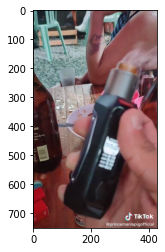

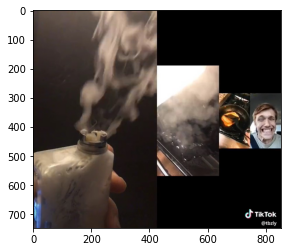

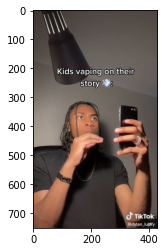

################## 13 ##################


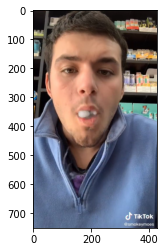

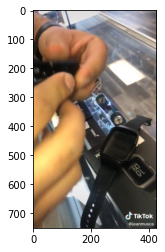

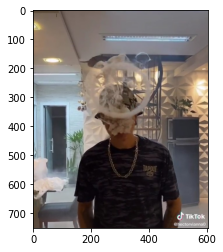

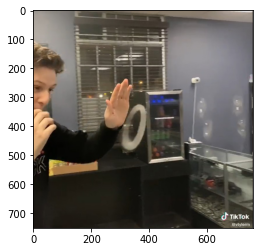

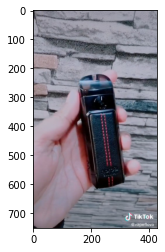

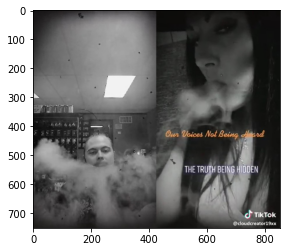

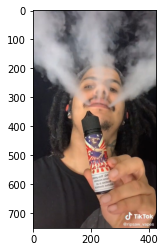

################## 14 ##################


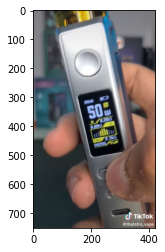

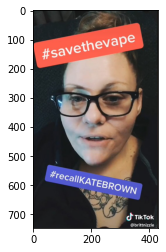

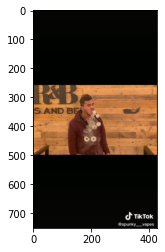

################## 15 ##################


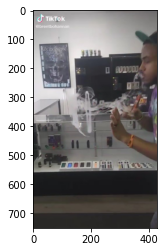

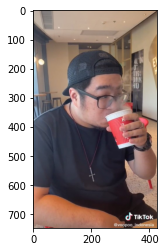

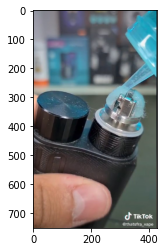

################## 16 ##################


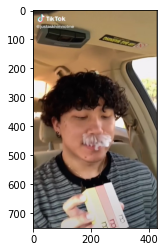

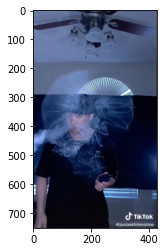

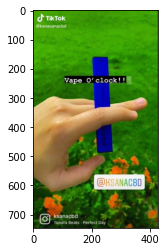

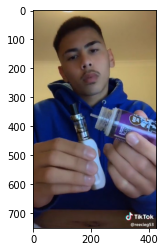

################## 17 ##################


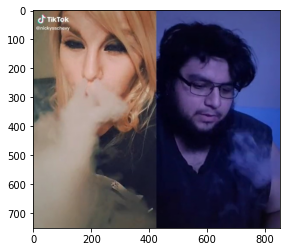

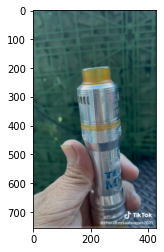

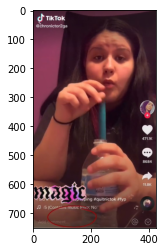

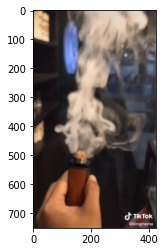

################## 18 ##################


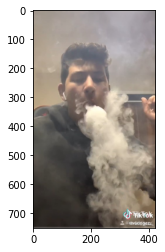

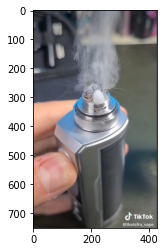

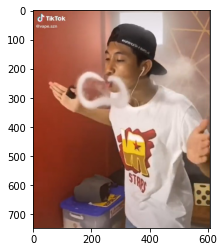

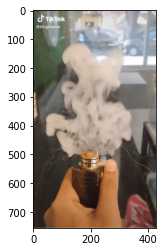

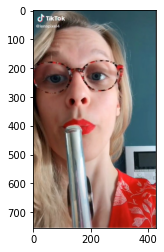

################## 19 ##################


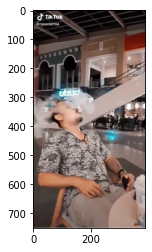

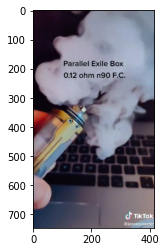

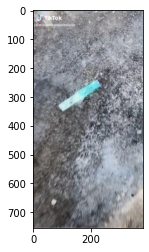

################## 20 ##################


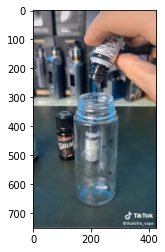

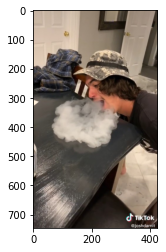

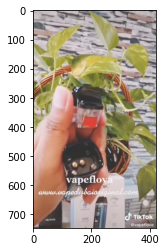

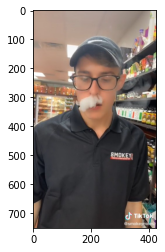

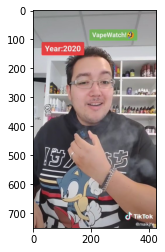

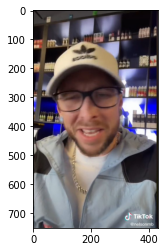

################## 21 ##################


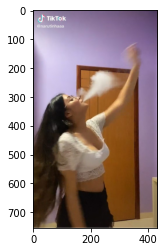

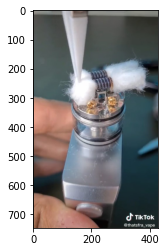

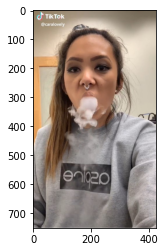

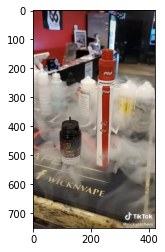

################## 22 ##################


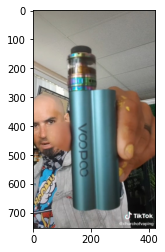

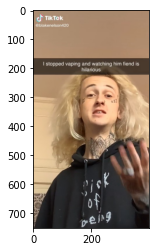

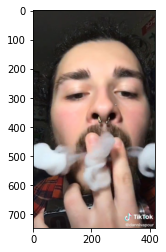

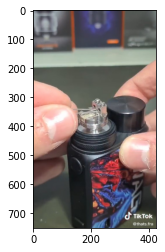

################## 23 ##################


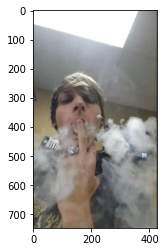

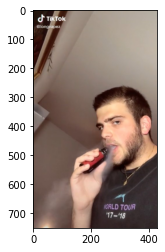

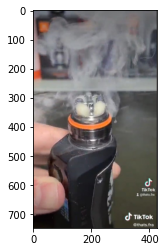

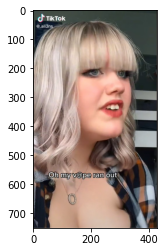

################## 24 ##################


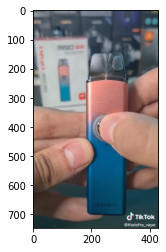

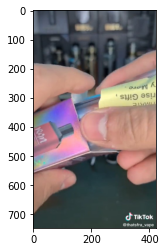

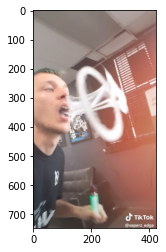

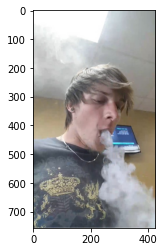

################## 25 ##################


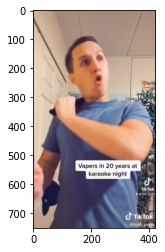

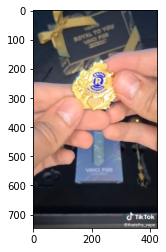

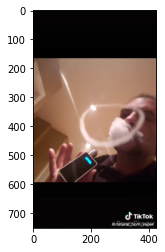

################## 26 ##################


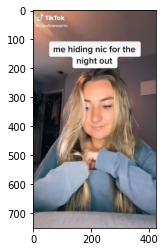

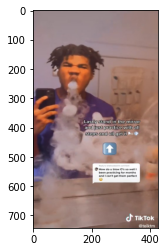

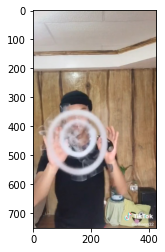

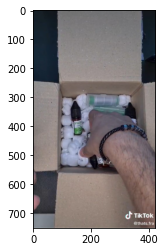

################## 27 ##################


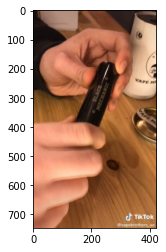

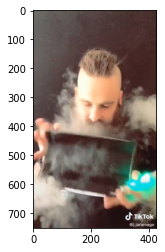

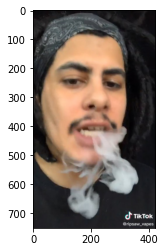

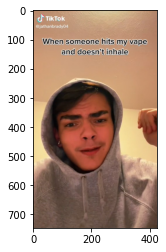

################## 28 ##################


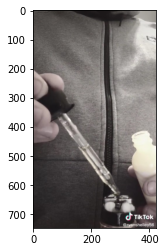

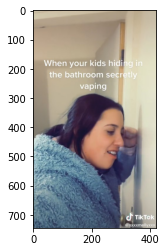

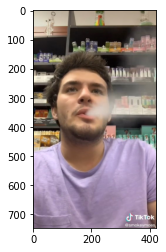

################## 29 ##################


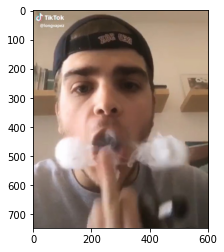

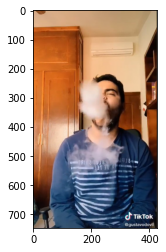

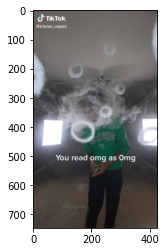

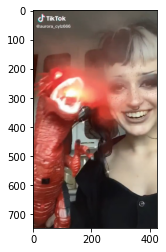

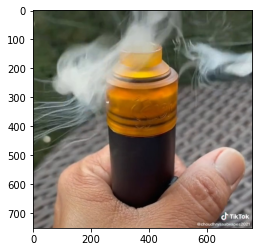

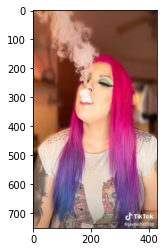

In [ ]:
for clust_no in range(0,30):
  print("##################",clust_no,"##################")
  clust_list = list(clust_in_df(df,clust_no))
  for im in clust_list: open_image(im)

In [ ]:
print(len(df))
'''
for i in range(len(df)):
  print(df.loc[i])
'''

for each in list(df.loc[0]): print(each)

838
/content/drive/MyDrive/Image-Clustering-v3/Screenshots/7029773319675153670.jpg
-1


### Corrected Grid Experiment 

In [ ]:
5 5 0.03
5 6 0.01

In [ ]:
#                                                                           Parameters
input_shape = 224
model       = keras.applications.VGG16(include_top=False,weights='imagenet',input_shape=(input_shape,input_shape,3),pooling='avg')
epsilon     = 10e-10

In [ ]:
grid = stats_experiment_loop(model,input_shape,exp_norm,[1,10,1],[2,9,1],[0.01,0.1,0.01])
save_grid(grid,'corrected_stat_grid')

1/1 [==============================] - 0s 17ms/step
(838, 512)
###############################################
number of pca components 1
###############################################
___________________________________________________________________
number of clusters    :  273
classified points     :  776
average cluster pop   :  2.8424908424908426
standard deviation    :  3.705098781477254
1 2 0.01
___________________________________________________________________
number of clusters    :  272
classified points     :  773
average cluster pop   :  2.8419117647058822
standard deviation    :  3.88635461102429
1 2 0.02
___________________________________________________________________
number of clusters    :  271
classified points     :  771
average cluster pop   :  2.8450184501845017
standard deviation    :  4.010453925655477
1 2 0.03
___________________________________________________________________
number of clusters    :  270
classified points     :  767
average cluster pop   :

In [ ]:
grid = read_grid('corrected_stat_grid')
search_stat_grid(grid,[0,40],[0,1000],[0,100],[1,100],return_list=False)

1 {'clusters': 37, 'coverage': 300, 'avg': 8.108108108108109, 'std': 85.93656246583362, 'stats': '2_5_0.09'}
2 {'clusters': 38, 'coverage': 370, 'avg': 9.736842105263158, 'std': 73.40154428621449, 'stats': '2_6_0.02'}
3 {'clusters': 38, 'coverage': 365, 'avg': 9.605263157894736, 'std': 74.20382575199667, 'stats': '2_6_0.03'}
4 {'clusters': 35, 'coverage': 342, 'avg': 9.771428571428572, 'std': 81.01391162973815, 'stats': '2_6_0.04'}
5 {'clusters': 34, 'coverage': 320, 'avg': 9.411764705882353, 'std': 85.93837818047685, 'stats': '2_6_0.05'}
6 {'clusters': 34, 'coverage': 314, 'avg': 9.235294117647058, 'std': 86.98136458729036, 'stats': '2_6_0.060000000000000005'}
7 {'clusters': 33, 'coverage': 311, 'avg': 9.424242424242424, 'std': 88.74407855412423, 'stats': '2_6_0.06999999999999999'}
8 {'clusters': 29, 'coverage': 285, 'avg': 9.827586206896552, 'std': 99.1516931977032, 'stats': '2_6_0.08'}
9 {'clusters': 36, 'coverage': 389, 'avg': 10.805555555555555, 'std': 72.08737411067794, 'stats': 

In [ ]:
res = search_stat_grid(grid,[0,30],[200,1000],[0,800],[1,1000],return_list=True)
res = sorted(res, key=lambda x: x['clusters'], reverse=True)
for each in res: print(each)

{'clusters': 30, 'coverage': 322, 'avg': 10.733333333333333, 'std': 90.74173363024437, 'stats': '2_7_0.05'}
{'clusters': 30, 'coverage': 299, 'avg': 9.966666666666667, 'std': 95.00944982240216, 'stats': '3_6_0.01'}
{'clusters': 29, 'coverage': 285, 'avg': 9.827586206896552, 'std': 99.1516931977032, 'stats': '2_6_0.08'}
{'clusters': 29, 'coverage': 307, 'avg': 10.586206896551724, 'std': 94.99304686989798, 'stats': '2_7_0.060000000000000005'}
{'clusters': 29, 'coverage': 238, 'avg': 8.206896551724139, 'std': 107.96210855972163, 'stats': '4_5_0.02'}
{'clusters': 29, 'coverage': 229, 'avg': 7.896551724137931, 'std': 109.65945556588335, 'stats': '4_5_0.03'}
{'clusters': 29, 'coverage': 250, 'avg': 8.620689655172415, 'std': 105.73139188286846, 'stats': '5_5_0.02'}
{'clusters': 29, 'coverage': 223, 'avg': 7.689655172413793, 'std': 110.79410691025235, 'stats': '6_5_0.01'}
{'clusters': 28, 'coverage': 272, 'avg': 9.714285714285714, 'std': 103.26281607468137, 'stats': '3_6_0.02'}
{'clusters': 27

### Single Correction Experiment

In [ ]:
#vgg16  20 3 0.05
#RNet50 30 3 0.03


In [ ]:
#                                                                           Parameters
input_shape = 224
model       = keras.applications.ResNet50(include_top=False,weights='imagenet',input_shape=(input_shape,input_shape,3),pooling='avg')
algorithm   = OPTICS(min_samples=6, xi=0.01)
components  = 5
epsilon     = 10e-10

In [ ]:
embedding_df           = get_embeddings(model,input_shape,exp_norm)
embedding_df

1/1 [==============================] - 0s 20ms/step
(838, 2048)


,0,1,2,3,4,5,6,7,8,9,...,2039,2040,2041,2042,2043,2044,2045,2046,2047,image
0,0.087054,0.284907,0.250195,1.000000,0.211053,0.583023,0.330627,0.492481,0.816707,0.398235,...,0.699589,0.199298,0.288797,0.091030,0.406680,0.662520,1.000000,1.000000,0.170566,/content/drive/MyDrive/Image-Clustering-v3/Scr...
1,0.158322,0.773142,0.328332,0.124382,0.974190,0.498762,0.076711,0.638798,0.622585,1.000000,...,0.997347,1.000000,0.891903,0.096771,0.327358,0.410427,0.390459,0.167983,0.017073,/content/drive/MyDrive/Image-Clustering-v3/Scr...
2,0.084219,0.365476,0.933521,0.971060,0.828123,0.870662,0.672679,0.362310,1.000000,0.991719,...,0.984076,0.805601,0.819490,0.416933,0.988037,0.382767,0.515525,0.839905,0.085521,/content/drive/MyDrive/Image-Clustering-v3/Scr...
3,0.308856,0.457908,0.892646,0.899037,0.694661,0.685492,0.155407,0.391789,0.706588,0.724506,...,0.974710,0.757867,0.875602,0.239168,0.655761,0.880923,0.939019,1.000000,0.215164,/content/drive/MyDrive/Image-Clustering-v3/Scr...
4,0.146835,0.460125,0.524031,0.137641,0.028138,0.098353,0.231027,0.505498,0.972582,0.647795,...,0.423745,0.231038,0.048573,0.270639,0.929712,1.000000,0.395363,0.496023,0.552010,/content/drive/MyDrive/Image-Clustering-v3/Scr...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
833,0.917899,0.885443,0.832870,1.000000,0.536820,1.000000,0.908087,0.998566,0.858695,0.057509,...,0.909184,0.954096,1.000000,0.661143,0.916379,0.994929,0.970938,0.785625,0.941278,/content/drive/MyDrive/Image-Clustering-v3/Scr...
834,1.000000,0.715383,1.000000,0.905514,0.992103,0.445044,1.000000,0.520601,0.042738,1.000000,...,0.859659,0.703781,0.998014,0.824976,0.901394,0.926412,1.000000,0.704192,1.000000,/content/drive/MyDrive/Image-Clustering-v3/Scr...
835,0.655427,0.298883,0.112349,0.281991,0.996153,0.560760,0.415824,0.156643,0.250506,0.440136,...,0.806662,0.368157,0.613985,0.226204,0.560548,1.000000,0.448313,0.183047,0.612620,/content/drive/MyDrive/Image-Clustering-v3/Scr...
836,0.842716,0.136917,0.229512,0.403144,0.493359,0.543402,0.380746,0.056676,0.637758,0.214617,...,0.406370,0.314969,0.152048,0.929920,1.000000,0.804462,0.644196,0.977592,0.583921,/content/drive/MyDrive/Image-Clustering-v3/Scr...


In [ ]:
principal_cp = dimension_reduction(embedding_df,components)
df,classes,avg_pop = image_clustering(embedding_df,principal_cp,algorithm)

###############################################
number of pca components 5
###############################################
___________________________________________________________________
number of clusters    :  22
classified points     :  222
average cluster pop   :  10.090909090909092
standard deviation    :  126.21155007328301


################## 0 ##################


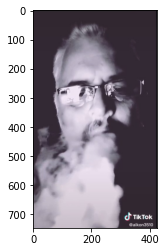

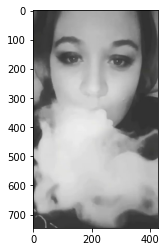

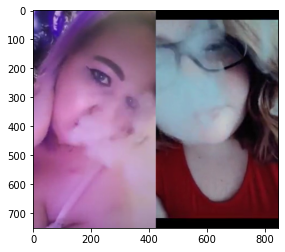

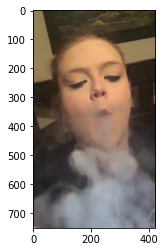

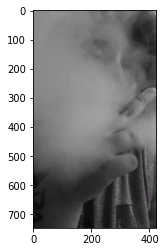

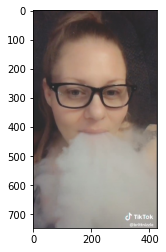

################## 1 ##################


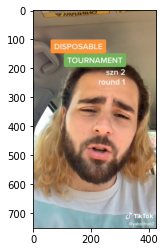

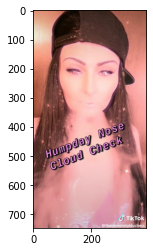

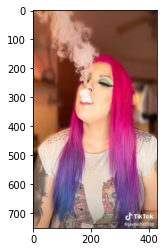

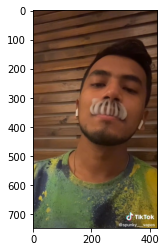

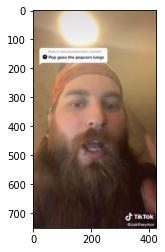

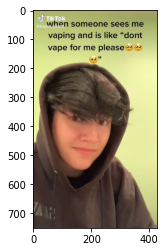

################## 2 ##################


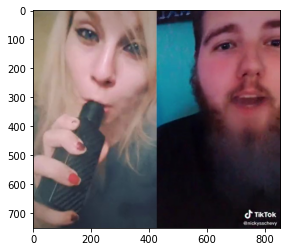

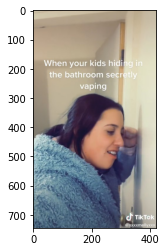

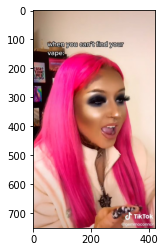

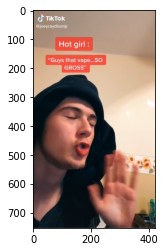

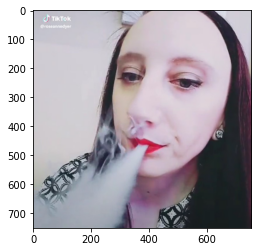

...

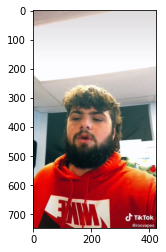

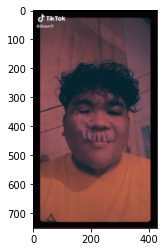

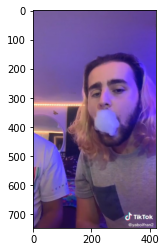

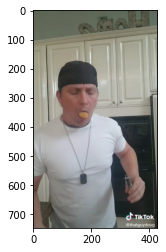

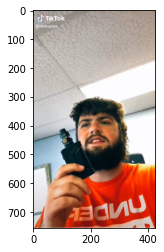

################## 3 ##################


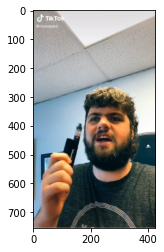

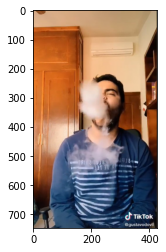

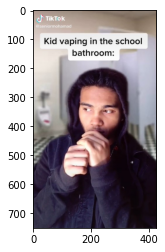

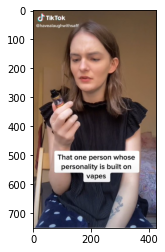

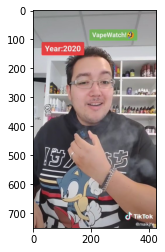

...

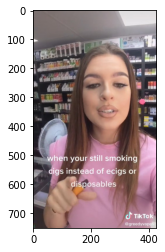

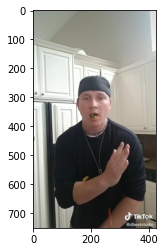

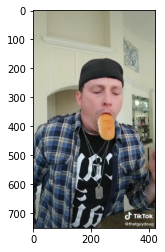

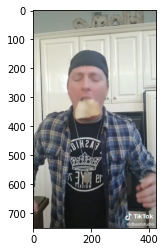

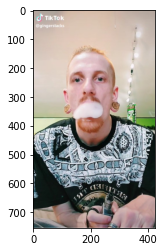

################## 4 ##################


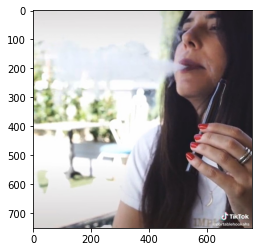

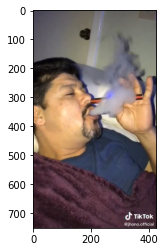

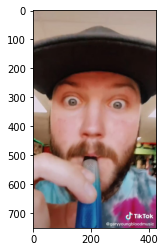

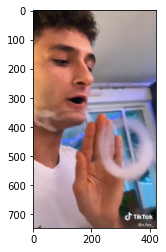

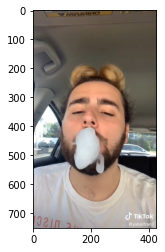

...

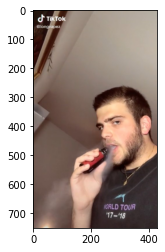

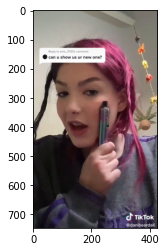

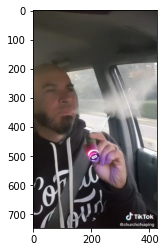

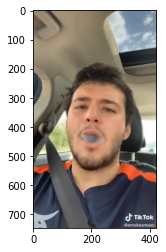

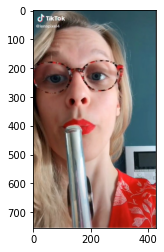

################## 5 ##################


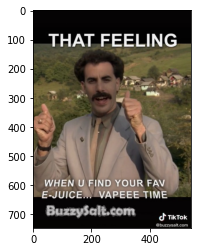

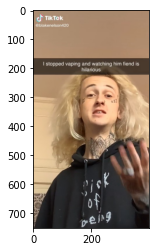

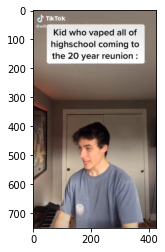

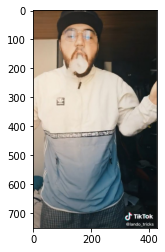

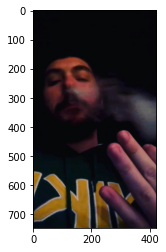

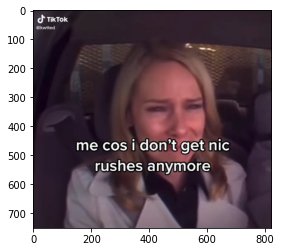

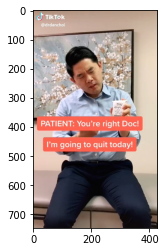

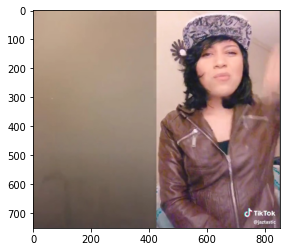

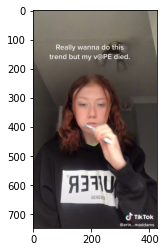

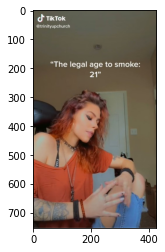

################## 6 ##################


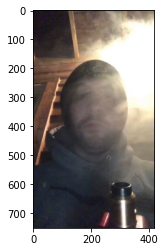

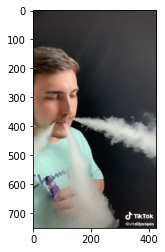

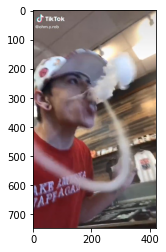

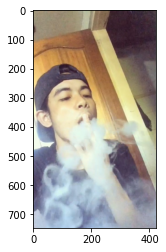

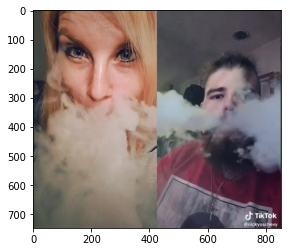

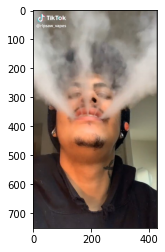

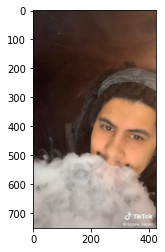

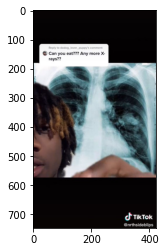

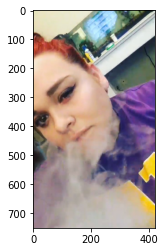

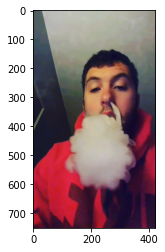

################## 7 ##################


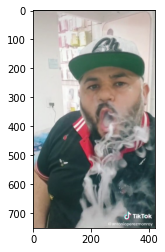

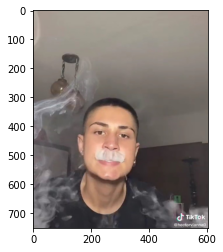

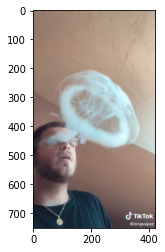

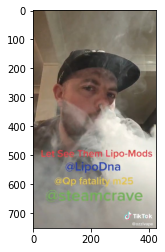

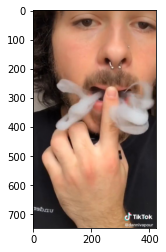

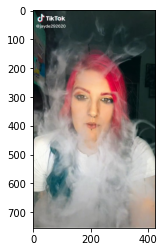

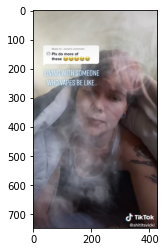

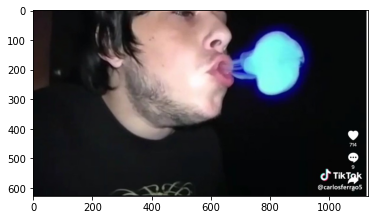

################## 8 ##################


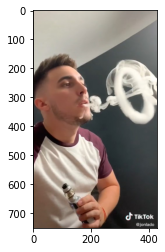

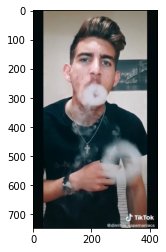

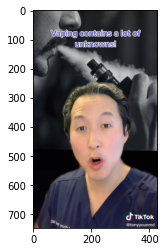

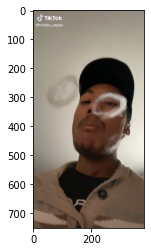

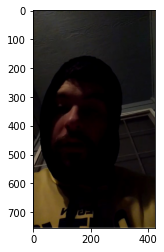

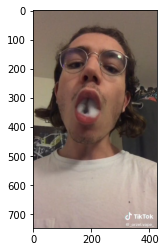

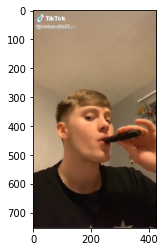

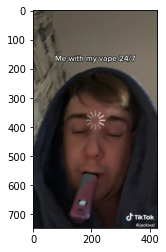

################## 9 ##################


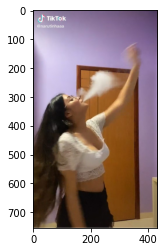

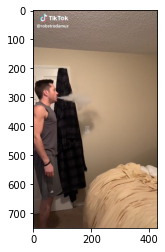

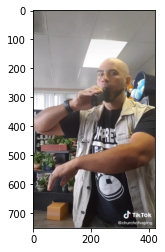

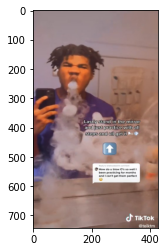

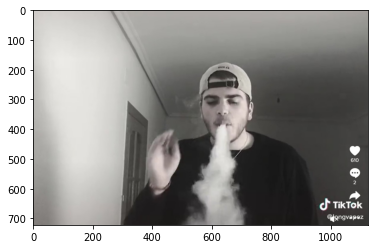

...

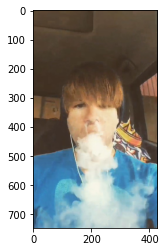

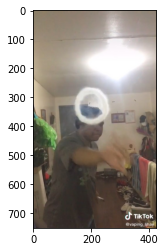

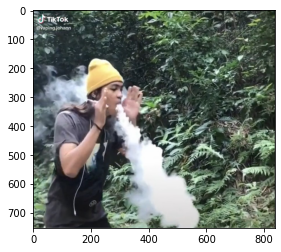

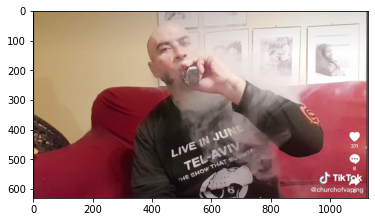

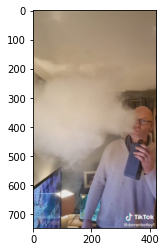

################## 10 ##################


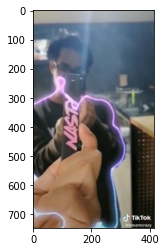

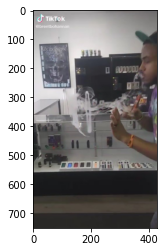

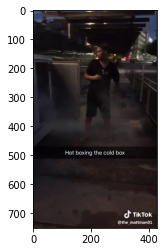

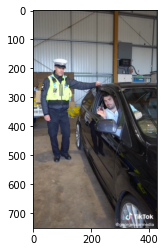

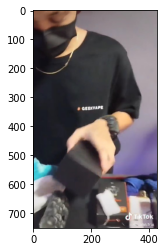

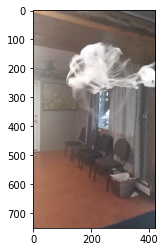

################## 11 ##################


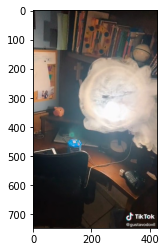

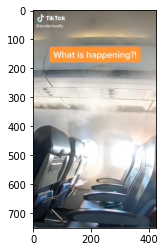

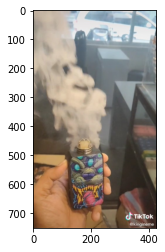

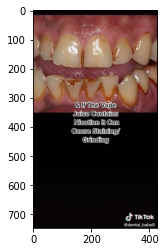

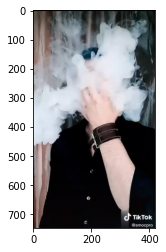

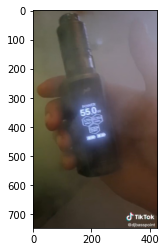

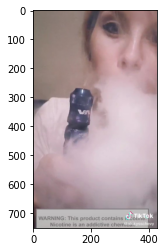

################## 12 ##################


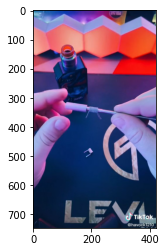

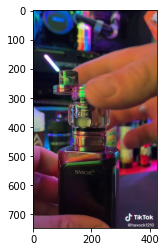

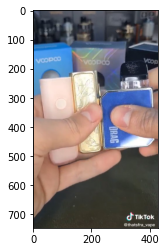

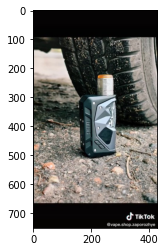

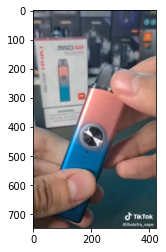

...

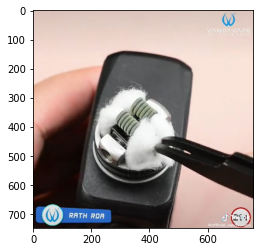

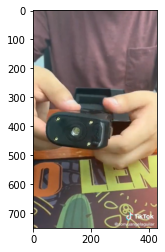

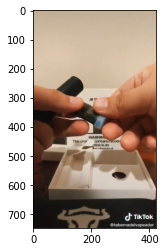

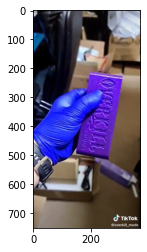

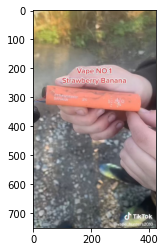

################## 13 ##################


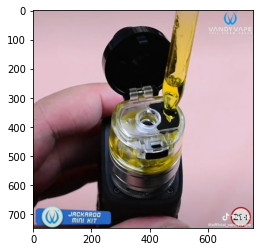

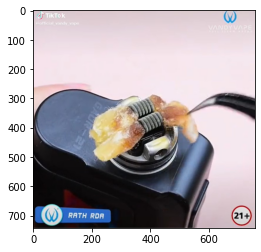

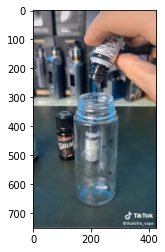

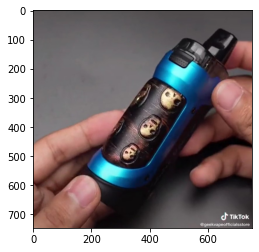

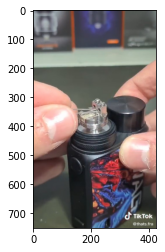

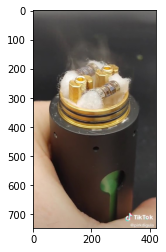

################## 14 ##################


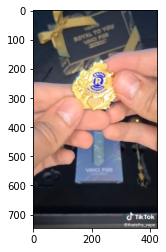

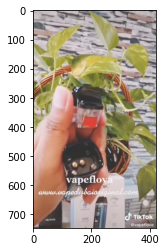

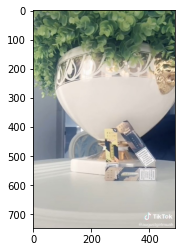

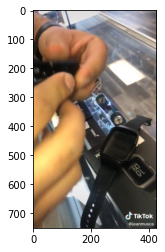

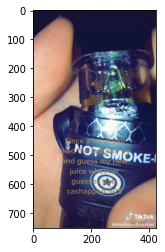

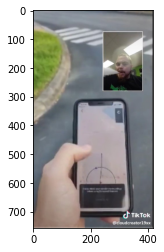

################## 15 ##################


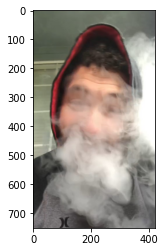

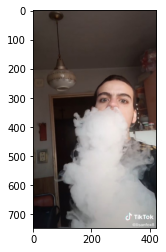

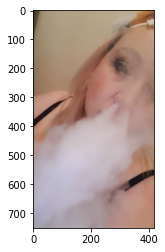

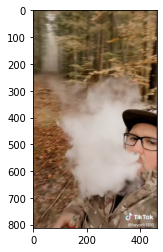

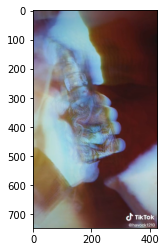

...

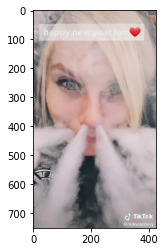

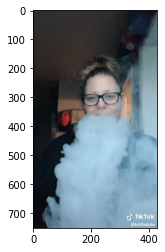

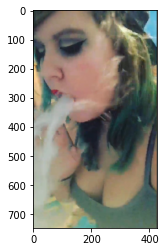

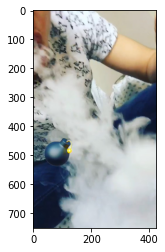

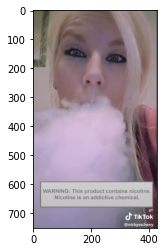

################## 16 ##################


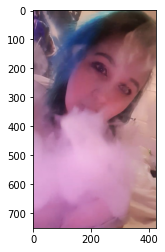

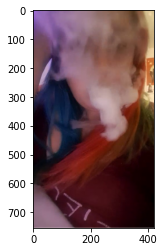

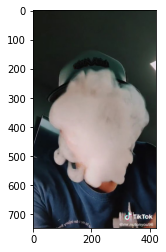

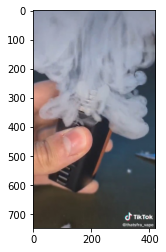

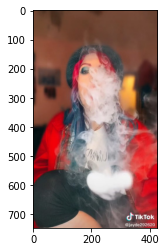

...

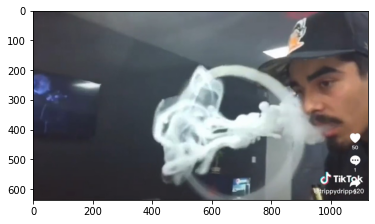

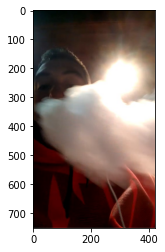

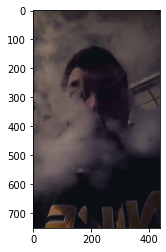

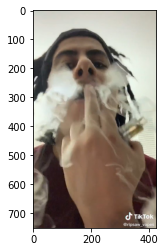

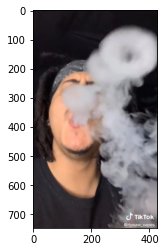

################## 17 ##################


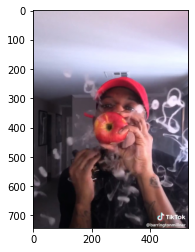

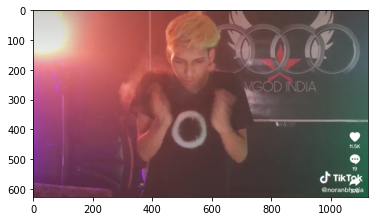

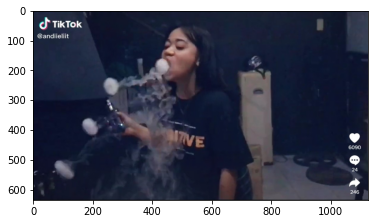

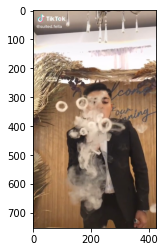

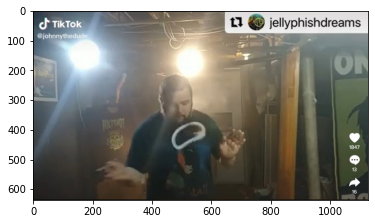

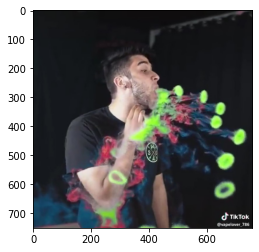

################## 18 ##################


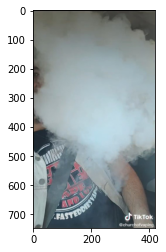

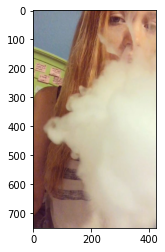

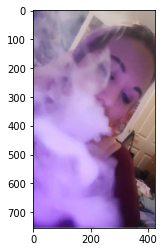

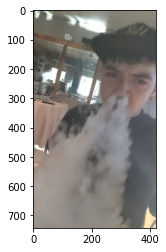

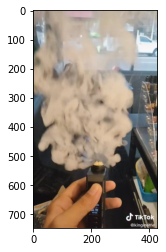

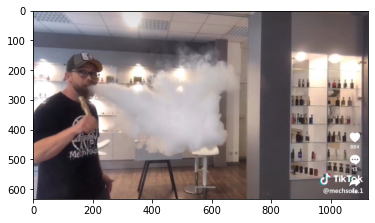

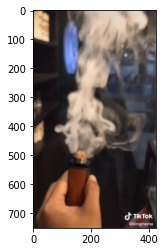

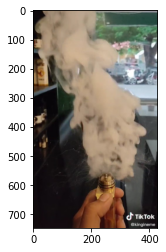

################## 19 ##################


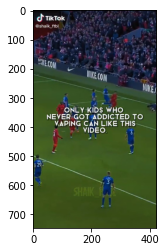

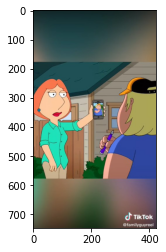

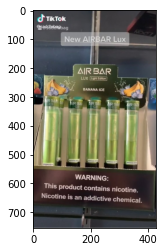

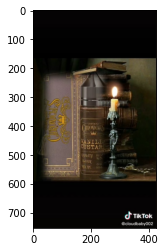

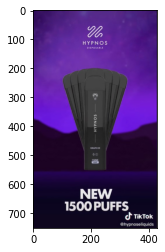

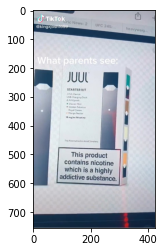

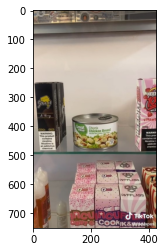

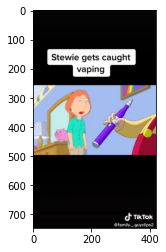

################## 20 ##################


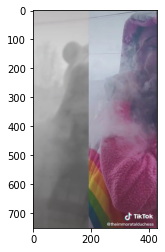

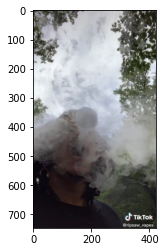

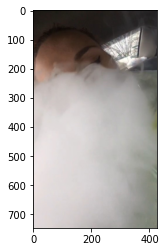

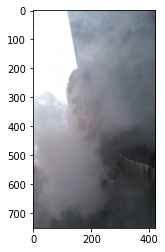

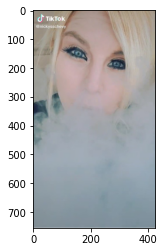

...

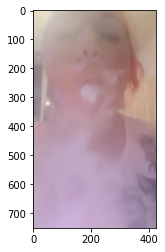

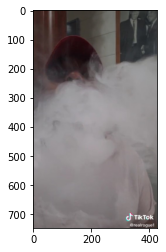

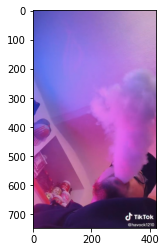

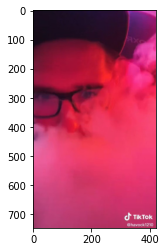

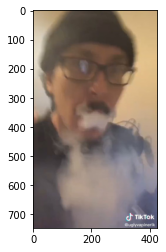

################## 21 ##################
################## 22 ##################
################## 23 ##################
################## 24 ##################
################## 25 ##################
################## 26 ##################
################## 27 ##################
################## 28 ##################
################## 29 ##################


In [ ]:
lis = []
for clust_no in range(0,30):
  print("##################",clust_no,"##################")
  clust_list = list(clust_in_df(df,clust_no))
  lis.append(len(clust_list))
  for im in clust_list: open_image(im)
print(lis)

In [ ]:
lis = []
for clust_no in range(0,100):
  clust_list = list(clust_in_df(df,clust_no))
  if len(clust_list)>0: lis.append(len(clust_list))
print(lis)

[6, 6, 11, 15, 13, 10, 10, 8, 8, 13, 6, 7, 23, 6, 6, 12, 24, 6, 8, 8, 16]


### Correction Evidence

In [ ]:
#                                                                           Parameters
input_shape = 224
model       = keras.applications.VGG16(include_top=False,weights='imagenet',input_shape=(input_shape,input_shape,3),pooling='avg')
algorithm   = OPTICS(min_samples=3, xi=0.05)
components  = 20
epsilon     = 10e-10

58889256/58889256 [==============================] - 3s 0us/step


In [ ]:
embedding_df           = get_embeddings(model,input_shape,False).reset_index()

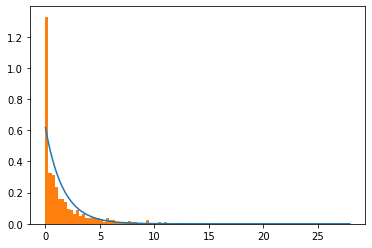

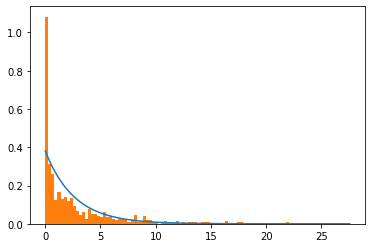

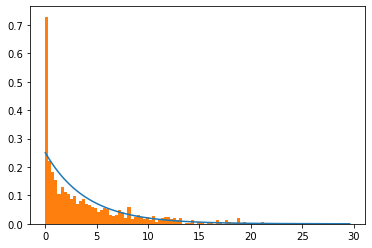

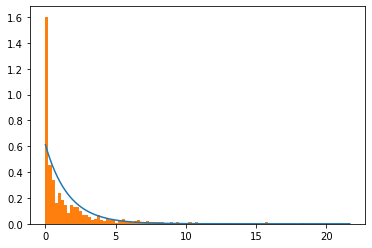

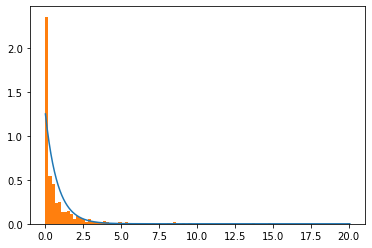

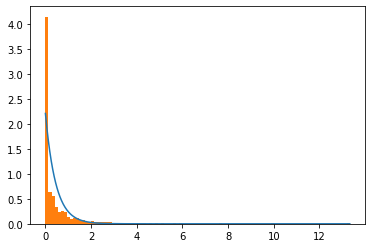

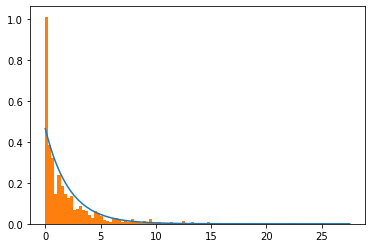

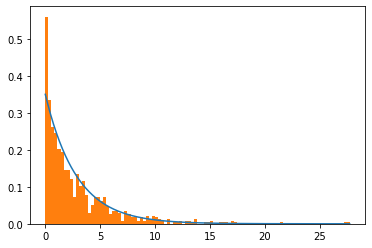

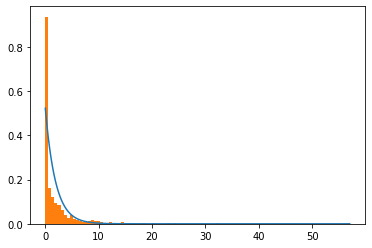

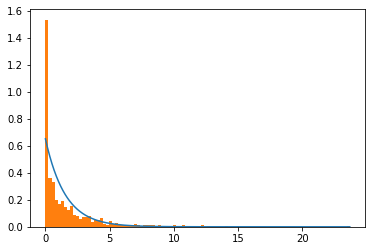

In [ ]:
for i in range(10):
  lam = 1/(embedding_df[i].mean()+10e-10)
  x = np.linspace(0,embedding_df[i].max(),len(embedding_df[i]))
  lis = list(embedding_df[i])
  lis.sort()
  plt.plot(x,lam*np.exp(-lam*x))
  plt.hist(lis,bins=100,density=True)
  plt.show()

In [ ]:
embedding_df.mean()

<ipython-input-28-e849438b2765>:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  embedding_df.mean()


index    418.500000
0          1.619347
1          2.630083
2          3.989168
3          1.634595
            ...    
507        1.824598
508        2.838078
509        3.015765
510        2.850513
511        0.844157
Length: 513, dtype: float64

In [ ]:
embedding_df

,index,0,1,2,3,4,5,6,7,8,...,503,504,505,506,507,508,509,510,511,image
0,0,0.502005,8.077882,5.296745,6.659776,1.361851,0.192825,5.450482,0.628101,0.005162,...,2.111467,0.000000,0.000000,1.880706,1.551268,2.425492,7.197327,4.571709,0.151979,/content/drive/MyDrive/Image-Clustering-v3/Scr...
1,1,0.085936,3.867893,1.739090,1.297629,1.724607,0.565149,0.000000,4.943489,0.000000,...,0.650163,0.000000,3.089921,0.887064,4.133459,0.648937,24.202297,10.053329,0.750646,/content/drive/MyDrive/Image-Clustering-v3/Scr...
2,2,0.049696,0.112166,1.568918,0.000000,0.008140,0.410622,0.000000,2.855428,0.369852,...,1.191587,0.571049,0.000000,0.102170,1.073099,0.158004,0.391944,2.674144,1.387554,/content/drive/MyDrive/Image-Clustering-v3/Scr...
3,3,0.359758,1.352652,0.840787,0.244337,0.000000,0.000000,0.114583,1.040070,0.821625,...,0.346472,0.921794,1.863625,1.239189,0.000000,0.438838,0.199853,0.303771,0.000000,/content/drive/MyDrive/Image-Clustering-v3/Scr...
4,4,0.000000,0.406834,0.467324,0.000000,0.263387,0.000000,2.248111,1.536185,1.547099,...,0.881968,0.901069,2.460844,0.128837,0.246847,0.449604,2.340099,2.636538,0.097030,/content/drive/MyDrive/Image-Clustering-v3/Scr...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
833,833,0.298648,0.000000,0.000000,0.117031,1.427592,0.690456,3.980458,0.000000,0.000000,...,0.143481,0.601401,0.076146,6.101776,0.000000,0.000000,0.046930,1.493325,0.044172,/content/drive/MyDrive/Image-Clustering-v3/Scr...
834,834,0.000000,0.000000,0.000000,0.000000,3.310964,0.000000,0.109776,0.000000,0.000000,...,0.000000,0.000000,0.245550,0.000000,0.343034,0.000000,5.264688,1.265821,0.033154,/content/drive/MyDrive/Image-Clustering-v3/Scr...
835,835,2.585273,2.509174,1.282900,1.587114,0.489977,0.000000,0.648160,2.940530,0.018479,...,8.285556,0.280211,0.332245,1.981738,2.099720,2.986639,2.959482,4.149272,3.600827,/content/drive/MyDrive/Image-Clustering-v3/Scr...
836,836,2.928822,5.138607,6.991542,4.518559,0.000000,0.164427,0.434509,1.126652,8.774543,...,1.919562,0.780483,1.643944,0.603747,3.419794,1.355015,9.111095,0.161236,0.302997,/content/drive/MyDrive/Image-Clustering-v3/Scr...


In [ ]:
if normalize is not None : embedding_df = normalize(embedding_df)
    embedding_df['image'] = embedding_df.index
    embedding_df = embedding_df.reset_index()
    embedding_df = embedding_df.drop(['index'], axis=1)